# Rendu 1 : Rapport d’exploration, de data visualisation et de pre-processing des données

## Introduction au projet

En tant que Data Scientist, le projet OCR s'inscrit dans le cadre de l'analyse et du traitement automatisé des données textuelles. L'objectif est de développer des modèles permettant de convertir des documents manuscrits en données exploitables, facilitant ainsi la prise de décision basée sur des informations précises et structurées.

On appliquera des méthodes de ML et Deep Learning pour l'extraction des informations textuelles et la classification des images. Nous allons utiliser deux approches, que nous confronterons par la suite avec un algorithme de votes et de boosting :
- Modèle d'OCR complété d'un modèle de de NLP (performe mieux s'il y a beaucoup de texte)
- Modèle de CNN (performe mieux s'il y a peu de texte)

Les datasets sur lesquels nous allons travailler sont les suivants :
- Dataset [RVL-CDIP](https://www.google.com/url?q=https%3A%2F%2Fadamharley.com%2Frvl-cdip%2F) pour la classification des documents : 400,000 images  classifiées en 16 catégories (taille : 37GB).
- Dataset [text-extraction-for-ocr de Kaggle](https://www.google.com/url?q=https%3A%2F%2Fwww.kaggle.com%2Fdatasets%2Fmanishthem%2Ftext-extraction-for-ocr%2Fdata) pour le benchmark des méthodes d'OCR (contient la localisation des marges et des différentes parties de l’image, la localisation des zones de texte ainsi que les caractères qu’elles contiennent en Unicode) : 520 images sous forme de .tif avec fichiers XML pour OCR (x2 par image).

Ce travaille de classification dépendra fortement de la qualité du dataset d'entraînement. C'est pourquoi, nous allons démarrer ce projet par une visualisation graphique de ses éléments afin de comprendre les principales étapes de pré-processing à réaliser.

*PS: Importons en amont l'ensemble des librairies et méthodes qui serons utilisées par la suite.*

In [26]:
## Imports
import os
import cv2
import glob
import matplotlib.pyplot as plt
import plotly.subplots as sp
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
import xml.etree.ElementTree as ET
from wordcloud import STOPWORDS, WordCloud
from collections import Counter
import pytesseract
import string

## Data Visualisation

Etudions en parallèle les éléments des deux datasets.

###  Kaggle dataset

Préparons une liste principale avec les images ainsi que des tableau numpy d'informations qui seront à analyser : les tailles, résolutions, distribution de couleur et luminosité. Enfin, regardons le premier élément pour avoir une idée plus précise des types d'éléments considérés.

In [27]:
# Chemin vers le répertoire principal contenant tous les documents
path_to_main_directory = r"./../data/raw/ImageAndXML_Data"

# Définir le chemin vers l'exécutable Tesseract si nécessaire
pytesseract.pytesseract.tesseract_cmd = r'/opt/homebrew/bin/tesseract'

# Initialiser les listes vides pour stocker les informations
image_paths = []
images = []
sizes = []
resolutions = []
color_distributions = []
brightness = []
letter_sizes = []
word_counts = []
most_frequent_words = []
black_pixel_percentages = []

# Définir les mots sans intérêt
stopwords = set(STOPWORDS)

# Itérer sur tous les fichiers dans le répertoire principal et ajouter les images .tif à la liste
for filename in os.listdir(path_to_main_directory):
    if filename.lower().endswith('.tif'):
        img_path = os.path.join(path_to_main_directory, filename)
        file_path = os.path.join(path_to_main_directory, filename)
        img = cv2.imread(img_path)
        if img is not None:
            image_paths.append(img_path)
            images.append(img)

            # Extraire la taille de l'image
            file_size = os.path.getsize(file_path)
            sizes.append(file_size / 1_000_000)

            # Extraire la résolution de l'image
            resolution = img.shape[:2]
            resolutions.append(resolution)

            # Extraire la distribution des couleurs de l'image
            color_distribution = np.bincount(img.flatten(), minlength=256)
            color_distributions.append(color_distribution)

            # Calculer et stocker la luminosité moyenne
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            avg_brightness = np.mean(gray_img)
            brightness.append(avg_brightness)
            
            # Extraire le texte de l'image et Filtrer les mots inutiles
            text = pytesseract.image_to_string(img)
            words = text.split()
            words = [word.lower() for word in words if word not in string.punctuation and word.lower() not in STOPWORDS and len(word) > 1]
            
            # Taille moyenne des lettres
            letter_size = np.mean([len(word) for word in words])
            letter_sizes.append(letter_size)
            
            # Nombre moyen de mots
            word_count = len(words)
            word_counts.append(word_count)

            # Mots les plus fréquents (en enlevant les mots sans intérêts)
            most_frequent_words.extend(words)
            
            # Pourcentage de pixels noirs dans l'image
            black_pixel_count = np.sum(gray_img < 50)  # Threshold for black
            total_pixels = gray_img.size
            black_pixel_percentage = (black_pixel_count / total_pixels) * 100
            black_pixel_percentages.append(black_pixel_percentage)

# Convertir les listes en tableaux numpy pour une manipulation plus facile
sizes = np.array(sizes)
resolutions = np.array(resolutions)
color_distributions = np.array(color_distributions)
brightness = np.array(brightness)
letter_sizes = np.array(letter_sizes)
word_counts = np.array(word_counts)
most_frequent_words_count = Counter(most_frequent_words)
black_pixel_percentages = np.array(black_pixel_percentages)

print(f"Nombre total d'images .tif chargées : {len(images)}")

Nombre total d'images .tif chargées : 520


Première image sous plusieurs spectres de couleurs :


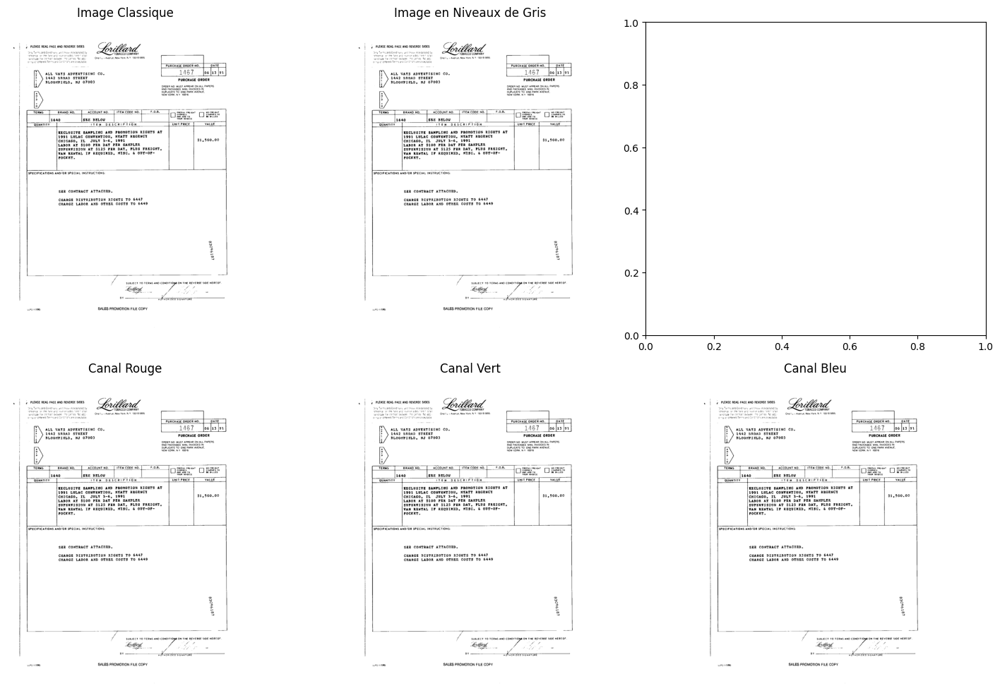

In [28]:
# Sélectionner un sous-ensemble de 1 image (la première image pour le sous-ensemble)
subset_images = images[:1]

# Préparer les images à afficher
rgb_image = cv2.cvtColor(subset_images[0], cv2.COLOR_BGR2RGB)
gray_image = cv2.cvtColor(subset_images[0], cv2.COLOR_BGR2GRAY)

# Séparer les canaux de couleur
b, g, r = cv2.split(subset_images[0])

# Afficher les images
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Première ligne
axes[0, 0].imshow(rgb_image)
axes[0, 0].set_title("Image Classique")
axes[0, 0].axis('off')

axes[0, 1].imshow(gray_image, cmap='gray')
axes[0, 1].set_title("Image en Niveaux de Gris")
axes[0, 1].axis('off')

# Deuxième ligne
axes[1, 0].imshow(cv2.cvtColor(r, cv2.COLOR_BGR2RGB))
axes[1, 0].set_title("Canal Rouge")
axes[1, 0].axis('off')

axes[1, 1].imshow(cv2.cvtColor(g, cv2.COLOR_BGR2RGB))
axes[1, 1].set_title("Canal Vert")
axes[1, 1].axis('off')

axes[1, 2].imshow(cv2.cvtColor(b, cv2.COLOR_BGR2RGB))
axes[1, 2].set_title("Canal Bleu")
axes[1, 2].axis('off')

print(f"Première image sous plusieurs spectres de couleurs :")
plt.tight_layout()
plt.show()

#### I. Analyse des formats

##### I.A. Distribution des Tailles d'Images
L'analyse de la distribution des tailles de fichiers permet de comprendre la variation des tailles d'images et de décider si une normalisation de la taille est nécessaire. En fonction des résultats, nous pouvons choisir de redimensionner les images pour une uniformité.

In [29]:
# Histogramme des tailles de fichiers
fig_sizes = px.histogram(x=sizes, nbins=50, title="Distribution des Tailles d'Images")
fig_sizes.update_layout(
    xaxis_title="Taille du Fichier (Mo)",
    yaxis_title="Nombre d'Images",
    showlegend=False,
    bargap=0.1,
    bargroupgap=0.1
)
fig_sizes.show(renderer='notebook')

**Commentaires**
- **Observation** : La majorité des images ont une taille de fichier comprise entre 0.05 et 0.1 Mo.
- **Recommandation** : Les images semblent être de taille appropriée pour les traitements ultérieurs. Cependant, les quelques images de plus grande taille (> 0.2 Mo) pourraient être compressées ou redimensionnées pour harmoniser la charge de traitement.

##### I.B. Résolutions des Images
L'analyse des résolutions des images permet de vérifier l'homogénéité des résolutions. Si les résolutions varient beaucoup, un redimensionnement des images peut être nécessaire pour garantir la cohérence dans le traitement ultérieur.

In [30]:
# Box plot des résolutions
res_widths = [res[1] for res in resolutions]
res_heights = [res[0] for res in resolutions]

fig_resolutions = go.Figure()

fig_resolutions.add_trace(go.Box(y=res_widths, name='Largeur des Images', boxpoints='all', jitter=0.3, pointpos=-1.8))
fig_resolutions.add_trace(go.Box(y=res_heights, name='Hauteur des Images', boxpoints='all', jitter=0.3, pointpos=-1.8))

fig_resolutions.update_layout(
    title="Box Plot des Résolutions d'Images",
    yaxis_title="Pixels"
)

fig_resolutions.show(renderer='notebook')

**Commentaires**
- **Observation** : La largeur des images varie principalement entre 750 et 800 pixels, tandis que la hauteur est uniformément à 1000 pixels.
- **Recommandation** : Pour assurer une uniformité dans les dimensions des images, un redimensionnement à une résolution standard (par exemple, 800x1000 pixels) pourrait être appliqué. Cela faciliterait les traitements et analyses subséquents.

##### I.C. Analyse de la Rotation des Images
Les documents écrits doivent être correctement orientés pour une reconnaissance optimale. Analyser l'orientation des images permet d'identifier les images nécessitant une correction de rotation.

In [31]:
# Analyser l'orientation des images en utilisant des techniques de détection de texte
def detect_text_orientation(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    edges = cv2.Canny(gray, 50, 150)
    lines = cv2.HoughLines(edges, 1, np.pi/180, 200)
    if lines is not None:
        angles = [line[0][1] for line in lines]
        return np.mean(angles)
    return 0

orientations = [detect_text_orientation(img) for img in images]

fig_orientations = px.histogram(x=orientations, nbins=50, title="Distribution des Angles d'Orientation des Images")
fig_orientations.update_layout(
    xaxis_title="Angle (radians)",
    yaxis_title="Nombre d'Images"
)
fig_orientations.show(renderer='notebook')

**Commentaires**
- **Observation** : Il y a une diversité dans l'orientation des images, avec une concentration autour de 1.5 radians.
- **Recommandation** : Une correction d'angle (rotation) pour aligner les textes horizontalement serait bénéfique. L'utilisation de la détection de l'angle d'orientation et la rotation corrective en conséquence pourrait standardiser l'orientation des documents.

#### II. Analyse du texte

##### II.A. Analyse du Contenu Texte et Bordures
Pour les documents écrits, il est crucial de s'assurer que le contenu texte est centré et bien contenu dans l'image. Cette analyse aide à déterminer si des ajustements de translation sont nécessaires pour recentrer le contenu.

In [32]:
# Utiliser une technique simple pour détecter le contenu texte et analyser la position
def detect_text_position(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    ret, thresh = cv2.threshold(gray, 150, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        x, y, w, h = cv2.boundingRect(contours[0])
        return (x + w // 2, y + h // 2)
    return (0, 0)

positions = [detect_text_position(img) for img in images]
x_positions, y_positions = zip(*positions)

fig_positions = px.scatter(x=x_positions, y=y_positions, title="Position du Contenu Texte dans les Images")
fig_positions.update_layout(
    xaxis_title="Position X",
    yaxis_title="Position Y"
)
fig_positions.show(renderer='notebook')

**Commentaires**
- **Observation** : La position du contenu texte est majoritairement en haut des images.
- **Recommandation** : Pour les analyses nécessitant l'extraction de texte, un recadrage automatique pour cibler les zones où le texte est principalement situé pourrait être mis en place. Cela permettrait de concentrer les efforts de traitement sur les zones d'intérêt.

##### II.B. Taille Moyenne des Lettres
La taille moyenne des lettres peut révéler des informations sur le type de document (par exemple, manuscrit vs imprimé). Une taille de lettre plus petite peut nécessiter une meilleure résolution pour la reconnaissance de caractères. Selon les résultats, une augmentation de la résolution ou un zoom sur les sections de texte pourrait être envisagé.

In [33]:
fig = px.histogram(x=letter_sizes, nbins=50, title="Distribution de la Taille Moyenne des Lettres")
fig.update_layout(xaxis_title="Taille Moyenne des Lettres", yaxis_title="Nombre de Documents")
fig.show()

**Commentaire** : A FAIRE

##### II.C. Nombre Moyen de Mots
Le nombre moyen de mots dans un document peut indiquer la densité d'information. Une densité de mots élevée peut nécessiter des techniques de prétraitement spécifiques comme la segmentation du texte. Selon les résultats, un traitement spécifique pour gérer les documents denses en texte pourrait être appliqué.

In [34]:
fig = px.histogram(x=word_counts, nbins=50, title="Distribution du Nombre Moyen de Mots")
fig.update_layout(xaxis_title="Nombre de Mots", yaxis_title="Nombre de Documents")
fig.show()

**Commentaire** : A FAIRE

##### II.D. Mots les Plus Fréquents
Identifier les mots les plus fréquents permet de comprendre le contenu principal des documents et d'éliminer les mots sans intérêt pour les analyses de texte. En fonction des résultats, une liste de mots à exclure pourrait être générée pour affiner les analyses de contenu.

In [35]:
fig = go.Figure([go.Bar(x=[word for word, count in most_frequent_words_count.most_common(10)], y=[count for word, count in most_frequent_words_count.most_common(10)])])
fig.update_layout(title="Mots les Plus Fréquents", xaxis_title="Mots", yaxis_title="Fréquence")
fig.show()

**Commentaire** : A FAIRE

#### III. Analyse des couleurs

##### III.A. Distribution des Intensités de Couleurs
Analyser la distribution des intensités de couleurs permet de comprendre la répartition des couleurs dans les images et d'identifier les éventuelles valeurs aberrantes. Cela aide à décider si un ajustement de la balance des couleurs ou une normalisation est nécessaire.

In [36]:
# Distribution des intensités de couleur en utilisant la somme
color_distribution_flat = np.sum(color_distributions, axis=0)

# Créer un graphique en barres avec échelle log
fig_colors = go.Figure(
    go.Bar(x=np.arange(256), y=color_distribution_flat, name="Distribution des Intensités de Couleurs")
)

fig_colors.update_layout(
    title="Distribution des Intensités de Couleurs",
    xaxis_title="Valeur de la Couleur",
    yaxis_title="Nombre de Pixels",
    yaxis_type="log"  # Utiliser une échelle logarithmique
)

fig_colors.show(renderer='notebook')

**Commentaires**
- **Observation** : Une majorité des pixels ont des valeurs d'intensité élevées, proche de 250.
- **Recommandation** : Il pourrait être bénéfique d'augmenter le contraste ou d'effectuer une égalisation d'histogramme pour les images où la majorité des pixels ont des valeurs d'intensité très similaires, afin d'améliorer la visibilité et la différenciation des caractéristiques.

##### III.B. Luminosité Moyenne
L'analyse de la luminosité moyenne des images permet de vérifier si les images ont des niveaux de luminosité cohérents. Des ajustements peuvent être nécessaires pour corriger les variations de luminosité afin d'assurer une qualité d'image uniforme.

In [37]:
# Histogramme de la luminosité moyenne avec échelle logarithmique
fig_brightness = px.histogram(x=brightness, nbins=50, title="Distribution de la Luminosité Moyenne")
fig_brightness.update_layout(
    xaxis_title="Luminosité Moyenne",
    yaxis_title="Nombre d'Images",
    yaxis_type="log"  # Utiliser une échelle logarithmique
)
fig_brightness.show(renderer='notebook')

**Commentaires**
- **Observation** : La plupart des images ont une luminosité moyenne élevée, avec un pic autour de 240.
- **Recommandation** : Pour les images avec une luminosité moyenne faible, une correction de luminosité pourrait être appliquée pour améliorer la lisibilité. Pour les images très lumineuses, une réduction de la luminosité pourrait être nécessaire pour éviter la saturation.

##### III.C. Distribution des Couleurs pour Chaque Image
Analyser la distribution des couleurs pour chaque image permet d'identifier les variations de couleur d'une image à l'autre. Cela peut aider à déterminer si des ajustements spécifiques par image sont nécessaires pour la normalisation des couleurs.

In [38]:
# Créer une liste de traces de barres pour chaque valeur de couleur
traces = []
for i in range(256):
    traces.append(go.Bar(x=np.arange(len(color_distributions)), y=color_distributions[:, i], name=str(i)))

# Créer la figure et définir la mise en page
fig_color_distributions = go.Figure(data=traces)
fig_color_distributions.update_layout(
    title="Distribution des Couleurs pour Chaque Image",
    xaxis_title="Indice de l'Image",
    yaxis_title="Nombre de Pixels",
    barmode="stack"
)

# Afficher le graphique
fig_color_distributions.show(renderer='notebook')

**Commentaires**
- **Observation** : Les couleurs sont uniformément réparties dans les images, avec des pics réguliers.
- **Recommandation** : Si des ajustements de couleur sont nécessaires, ils pourraient être basés sur les pics spécifiques identifiés. Par exemple, une normalisation des couleurs pourrait être envisagée.

##### III.D. Pourcentage de Pixels Noirs dans l'Image
Le pourcentage de pixels noirs peut indiquer la densité d'impression ou la présence d'arrière-plans sombres. Une forte densité de pixels noirs pourrait nécessiter un prétraitement pour améliorer le contraste. Selon les résultats, une augmentation du contraste ou un filtrage des pixels noirs pourrait être nécessaire.

In [39]:
fig = px.histogram(x=black_pixel_percentages, nbins=50, title="Distribution du Pourcentage de Pixels Noirs")
fig.update_layout(xaxis_title="Pourcentage de Pixels Noirs", yaxis_title="Nombre de Documents")
fig.show()

**Commentaire** : A FAIRE